In [1]:
import pandas as pd
import numpy as np


In [2]:
arquivo_resultado = "RESULTADO_LIG_PARAISOPOLIS_20260105.xlsx"
df_res = pd.read_excel(arquivo_resultado)

df_res.shape


(12540, 41)

In [3]:
df_res.columns.tolist()


['PDE',
 'ID_FORNECIMENTO',
 'NOME_SA_AC',
 'NOME_BE_AC',
 'CODIGO_IBG',
 'CD_SETOR',
 'CD_SUPERIN',
 'DATA_LIGAC',
 'DATA_LIG_1',
 'DS_ENT_ORG',
 'NR_ECON_IND',
 'NR_ECON_RES',
 'NR_ECON_PUB',
 'NR_FATOR_K',
 'MUNICIPIO',
 'NOME_BACIA',
 'NOME_SETOR',
 'RECORTE',
 'SIGLA_BACI',
 'SIGLA_SETO',
 'SITUACAO_FORNECIMENTO',
 'SITUACAO_A',
 'SITUACAO_E',
 'TL',
 'TRAT_ESG_D',
 'DS_TP_UTILIZACAO',
 'QTD_DEBITOS_ABERTOS',
 'VALOR_TOTAL_ABERTO',
 'FLAG_MIG_GEN',
 'TIPO_IMOVEL',
 'PERFIL_TARIFARIO',
 'ENQUADRA_TARIFA_SOCIAL',
 'ENDERECO_COMPLETO',
 'LATITUDE',
 'LONGITUDE',
 'DATA_LIGACAO_AGUA',
 'QTD_IRREGULARIDADES',
 'MEDIA_CONSUMO_12_MESES',
 'MEDIA_CONSUMO_24_MESES',
 'VEZES_ACIMA_DOBRO_MEDIA',
 'TEM_DEBITO']

In [4]:
colunas_interesse = [
    "PDE",
    "NR_ECON_IND",
    "NR_ECON_RES",
    "NR_ECON_PUB",
    "TL",
    "TIPO_IMOVEL",
    "PERFIL_TARIFARIO",
    "ENQUADRA_TARIFA_SOCIAL",
    "QTD_IRREGULARIDADES",
    "MEDIA_CONSUMO_12_MESES",
    "MEDIA_CONSUMO_24_MESES",
    "VEZES_ACIMA_DOBRO_MEDIA",
    "TEM_DEBITO",
    "QTD_DEBITOS_ABERTOS",
    "VALOR_TOTAL_ABERTO",
    "DATA_LIGACAO_AGUA",
    "LATITUDE",
    "LONGITUDE",
    "CD_SETOR"
]

# garante que só colunas existentes serão usadas
colunas_existentes = [c for c in colunas_interesse if c in df_res.columns]

df = df_res[colunas_existentes].copy()

df.head()


,PDE,NR_ECON_IND,NR_ECON_RES,NR_ECON_PUB,TL,TIPO_IMOVEL,PERFIL_TARIFARIO,ENQUADRA_TARIFA_SOCIAL,QTD_IRREGULARIDADES,MEDIA_CONSUMO_12_MESES,MEDIA_CONSUMO_24_MESES,VEZES_ACIMA_DOBRO_MEDIA,TEM_DEBITO,QTD_DEBITOS_ABERTOS,VALOR_TOTAL_ABERTO,DATA_LIGACAO_AGUA,LATITUDE,LONGITUDE,CD_SETOR
0,194075303,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL - 50% DA TARIFA RESIDENCIAL,SIM,0,20.769231,20.360000,0,1,1.0,89.52,1978-09-28,-23.611813,-46.725278,355030883000040
1,194082776,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL,SIM,0,0.000000,0.000000,0,1,4.0,11380.14,1984-05-10,-23.614600,-46.730358,355030883000363
2,194082857,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL,SIM,0,1.166667,1.750000,3,1,4.0,86.52,1986-10-13,-23.614557,-46.730353,355030883000363
3,194082938,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL - TRANSIÇÃO,SIM,0,0.833333,1.333333,2,1,22.0,537.61,1988-02-17,-23.615223,-46.730255,355030883000363
4,194083152,NaN,NaN,NaN,1,NaN,NaN,SIM,1,NaN,NaN,0,0,NaN,NaN,1982-12-29,-23.614367,-46.729672,355030883000363


In [5]:
diagnostico = pd.DataFrame({
    "coluna": df.columns,
    "tipo": df.dtypes.values,
    "nulos": df.isna().sum().values,
    "percentual_nulos": (df.isna().mean() * 100).round(2).values
})

diagnostico.sort_values("percentual_nulos", ascending=False)


,coluna,tipo,nulos,percentual_nulos
13,QTD_DEBITOS_ABERTOS,float64,2467,19.67
14,VALOR_TOTAL_ABERTO,float64,2467,19.67
9,MEDIA_CONSUMO_12_MESES,float64,1348,10.75
10,MEDIA_CONSUMO_24_MESES,float64,1285,10.25
6,PERFIL_TARIFARIO,object,922,7.35
1,NR_ECON_IND,float64,922,7.35
2,NR_ECON_RES,float64,922,7.35
3,NR_ECON_PUB,float64,922,7.35
5,TIPO_IMOVEL,object,922,7.35
15,DATA_LIGACAO_AGUA,datetime64[ns],1,0.01


In [6]:
# 1) Garantir que economias são numéricas e substituir nulos por 0
econ_cols = ["NR_ECON_IND", "NR_ECON_RES", "NR_ECON_PUB"]

for c in econ_cols:
    df[c] = pd.to_numeric(df[c], errors="coerce").fillna(0)

# 2) Total de economias
df["TOTAL_ECONOMIAS"] = df[econ_cols].sum(axis=1)

# 3) Quantos tipos de economia o cliente possui (>0)
df["QTD_TIPOS_ECONOMIA"] = (df[econ_cols] > 0).sum(axis=1)

# 4) Tipo de economia dominante (variável categórica muito forte)
def tipo_economia(row):
    if row["QTD_TIPOS_ECONOMIA"] == 0:
        return "SEM_ECONOMIA"
    if row["QTD_TIPOS_ECONOMIA"] > 1:
        return "MULTI"
    if row["NR_ECON_IND"] > 0:
        return "IND"
    if row["NR_ECON_RES"] > 0:
        return "RES"
    return "PUB"

df["TIPO_ECONOMIA_DOMINANTE"] = df.apply(tipo_economia, axis=1)

# 5) Conferência rápida
df[[
    "NR_ECON_IND",
    "NR_ECON_RES",
    "NR_ECON_PUB",
    "TOTAL_ECONOMIAS",
    "QTD_TIPOS_ECONOMIA",
    "TIPO_ECONOMIA_DOMINANTE"
]].head(10)


,NR_ECON_IND,NR_ECON_RES,NR_ECON_PUB,TOTAL_ECONOMIAS,QTD_TIPOS_ECONOMIA,TIPO_ECONOMIA_DOMINANTE
0,0.0,1.0,0.0,1.0,1,RES
1,0.0,1.0,0.0,1.0,1,RES
2,0.0,1.0,0.0,1.0,1,RES
3,0.0,1.0,0.0,1.0,1,RES
4,0.0,0.0,0.0,0.0,0,SEM_ECONOMIA
5,0.0,1.0,0.0,1.0,1,RES
6,0.0,0.0,0.0,0.0,0,SEM_ECONOMIA
7,0.0,1.0,0.0,1.0,1,RES
8,0.0,1.0,0.0,1.0,1,RES
9,0.0,1.0,0.0,1.0,1,RES


In [7]:
consumo_cols = ["MEDIA_CONSUMO_12_MESES", "MEDIA_CONSUMO_24_MESES"]

for c in consumo_cols:
    df[c] = pd.to_numeric(df[c], errors="coerce")
    mediana = df[c].median()
    df[c] = df[c].fillna(mediana)
    print(f"{c} — mediana usada: {mediana:.2f}")

df[consumo_cols].describe()


MEDIA_CONSUMO_12_MESES — mediana usada: 11.08
MEDIA_CONSUMO_24_MESES — mediana usada: 11.42


,MEDIA_CONSUMO_12_MESES,MEDIA_CONSUMO_24_MESES
count,12540.000000,12540.000000
mean,20.422521,19.966899
std,53.616137,52.501084
min,0.000000,0.000000
25%,5.000000,5.708333
50%,11.083333,11.423077
75%,19.916667,19.625000
max,3199.500000,2940.208333


In [8]:
# 1) Garantir tipos numéricos
df["TEM_DEBITO"] = df["TEM_DEBITO"].astype(int)

df["QTD_DEBITOS_ABERTOS"] = pd.to_numeric(df["QTD_DEBITOS_ABERTOS"], errors="coerce")
df["VALOR_TOTAL_ABERTO"] = pd.to_numeric(df["VALOR_TOTAL_ABERTO"], errors="coerce")

# 2) Para quem NÃO tem débito → zera tudo
mask_sem_debito = df["TEM_DEBITO"] == 0
df.loc[mask_sem_debito, "QTD_DEBITOS_ABERTOS"] = 0
df.loc[mask_sem_debito, "VALOR_TOTAL_ABERTO"] = 0

# 3) Para quem TEM débito → imputar mediana (somente entre inadimplentes)
mask_com_debito = df["TEM_DEBITO"] == 1

med_qtd = df.loc[mask_com_debito, "QTD_DEBITOS_ABERTOS"].median()
med_valor = df.loc[mask_com_debito, "VALOR_TOTAL_ABERTO"].median()

df.loc[mask_com_debito, "QTD_DEBITOS_ABERTOS"] = (
    df.loc[mask_com_debito, "QTD_DEBITOS_ABERTOS"].fillna(med_qtd)
)

df.loc[mask_com_debito, "VALOR_TOTAL_ABERTO"] = (
    df.loc[mask_com_debito, "VALOR_TOTAL_ABERTO"].fillna(med_valor)
)

print(f"Mediana QTD_DEBITOS_ABERTOS (inadimplentes): {med_qtd}")
print(f"Mediana VALOR_TOTAL_ABERTO (inadimplentes): {med_valor:.2f}")

# 4) Transformação log (reduz impacto de outliers)
df["VALOR_TOTAL_ABERTO_LOG"] = np.log1p(df["VALOR_TOTAL_ABERTO"])

df[[
    "TEM_DEBITO",
    "QTD_DEBITOS_ABERTOS",
    "VALOR_TOTAL_ABERTO",
    "VALOR_TOTAL_ABERTO_LOG"
]].describe()


Mediana QTD_DEBITOS_ABERTOS (inadimplentes): 48.0
Mediana VALOR_TOTAL_ABERTO (inadimplentes): 2199.31


,TEM_DEBITO,QTD_DEBITOS_ABERTOS,VALOR_TOTAL_ABERTO,VALOR_TOTAL_ABERTO_LOG
count,12540.000000,12540.000000,12540.000000,12540.000000
mean,0.776635,45.939155,3303.154471,5.704038
std,0.416518,47.016610,5749.460844,3.444421
min,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,22.150000,3.141995
50%,1.000000,45.000000,1115.170000,7.017658
75%,1.000000,90.000000,4151.257500,8.331407
max,1.000000,1538.000000,131422.770000,11.786182


In [9]:
cat_cols = [
    "TIPO_IMOVEL",
    "PERFIL_TARIFARIO",
    "ENQUADRA_TARIFA_SOCIAL",
    "TIPO_ECONOMIA_DOMINANTE"
]

for c in cat_cols:
    df[c] = (
        df[c]
        .astype("string")
        .fillna("DESCONHECIDO")
        .str.strip()
        .str.upper()
    )

# Conferência rápida
for c in cat_cols:
    print(f"\n{c}")
    print(df[c].value_counts().head(10))



TIPO_IMOVEL
TIPO_IMOVEL
RESIDENCIAL     11510
DESCONHECIDO      922
COMERCIAL          84
MISTA              14
PUBLICA             9
INDUSTRIAL          1
Name: count, dtype: Int64

PERFIL_TARIFARIO
PERFIL_TARIFARIO
SOCIAL - TRANSIÇÃO                    6399
FAVELA NORMAL                         1431
SOCIAL                                1101
DESCONHECIDO                           922
NORMAL                                 907
SOCIAL - 75% DA TARIFA RESIDENCIAL     895
RESIDENCIAL VULNERÁVEL                 666
SOCIAL - 50% DA TARIFA RESIDENCIAL     187
MISTA                                   14
NORMAL_IR                                7
Name: count, dtype: Int64

ENQUADRA_TARIFA_SOCIAL
ENQUADRA_TARIFA_SOCIAL
SIM    11633
NAO      907
Name: count, dtype: Int64

TIPO_ECONOMIA_DOMINANTE
TIPO_ECONOMIA_DOMINANTE
RES             11524
SEM_ECONOMIA     1006
PUB                 9
IND                 1
Name: count, dtype: Int64


In [10]:
# Converter para datetime (por segurança)
df["DATA_LIGACAO_AGUA"] = pd.to_datetime(df["DATA_LIGACAO_AGUA"], errors="coerce")

# Data de referência: hoje
data_ref = pd.Timestamp.today()

# Tempo de ligação em anos
df["TEMPO_LIGACAO_ANOS"] = (
    (data_ref - df["DATA_LIGACAO_AGUA"])
    .dt.days / 365.25
)

# Se houver algum caso raro sem data, imputamos pela mediana
mediana_tempo = df["TEMPO_LIGACAO_ANOS"].median()
df["TEMPO_LIGACAO_ANOS"] = df["TEMPO_LIGACAO_ANOS"].fillna(mediana_tempo)

print(f"Mediana de tempo de ligação (anos): {mediana_tempo:.1f}")

df["TEMPO_LIGACAO_ANOS"].describe()


Mediana de tempo de ligação (anos): 16.9


count    12540.000000
mean        19.529391
std          8.599358
min          0.900753
25%         15.931554
50%         16.887064
75%         21.839836
max         49.533196
Name: TEMPO_LIGACAO_ANOS, dtype: float64

In [11]:
# Lista oficial de variáveis do cluster
features_numericas = [
    "TOTAL_ECONOMIAS",
    "QTD_TIPOS_ECONOMIA",
    "MEDIA_CONSUMO_12_MESES",
    "MEDIA_CONSUMO_24_MESES",
    "VEZES_ACIMA_DOBRO_MEDIA",
    "QTD_IRREGULARIDADES",
    "TEM_DEBITO",
    "QTD_DEBITOS_ABERTOS",
    "VALOR_TOTAL_ABERTO_LOG",
    "TEMPO_LIGACAO_ANOS"
]

features_categoricas = [
    "TIPO_ECONOMIA_DOMINANTE",
    "TIPO_IMOVEL",
    "PERFIL_TARIFARIO",
    "ENQUADRA_TARIFA_SOCIAL",
    "TL"
]

# DataFrame final para cluster
X = df[features_numericas + features_categoricas].copy()

X.head()


,TOTAL_ECONOMIAS,QTD_TIPOS_ECONOMIA,MEDIA_CONSUMO_12_MESES,MEDIA_CONSUMO_24_MESES,VEZES_ACIMA_DOBRO_MEDIA,QTD_IRREGULARIDADES,TEM_DEBITO,QTD_DEBITOS_ABERTOS,VALOR_TOTAL_ABERTO_LOG,TEMPO_LIGACAO_ANOS,TIPO_ECONOMIA_DOMINANTE,TIPO_IMOVEL,PERFIL_TARIFARIO,ENQUADRA_TARIFA_SOCIAL,TL
0,1.0,1,20.769231,20.360000,0,0,1,1.0,4.505571,47.301848,RES,RESIDENCIAL,SOCIAL - 50% DA TARIFA RESIDENCIAL,SIM,1
1,1.0,1,0.000000,0.000000,0,0,1,4.0,9.339713,41.686516,RES,RESIDENCIAL,SOCIAL,SIM,1
2,1.0,1,1.166667,1.750000,3,0,1,4.0,4.471867,39.260780,RES,RESIDENCIAL,SOCIAL,SIM,1
3,1.0,1,0.833333,1.333333,2,0,1,22.0,6.288992,37.913758,RES,RESIDENCIAL,SOCIAL - TRANSIÇÃO,SIM,1
4,0.0,0,11.083333,11.423077,0,1,0,0.0,0.000000,43.049966,SEM_ECONOMIA,DESCONHECIDO,DESCONHECIDO,SIM,1


### 🧩 Pré-processamento dos dados para clusterização

Antes de aplicar algoritmos de cluster (como o K-Means), é necessário transformar a base de dados em uma matriz numérica padronizada. Isso é fundamental porque o K-Means utiliza **distâncias geométricas** (distância euclidiana) para agrupar observações, e diferenças de escala ou dados categóricos podem distorcer completamente o resultado.

#### 🔹 O que é feito nesta etapa?

Esta célula executa duas transformações principais:

##### 1️⃣ Normalização das variáveis numéricas
As variáveis numéricas (consumo, débitos, tempo de ligação, etc.) possuem escalas muito diferentes entre si.  
Por exemplo:
- Consumo médio pode variar de 0 a mais de 3.000 m³  
- Tempo de ligação varia de 0 a ~50 anos  
- Débitos podem chegar a dezenas de milhares de reais  

Para evitar que variáveis com valores maiores dominem o cálculo das distâncias, aplicamos o **StandardScaler**, que:
- Centraliza os dados na média 0
- Ajusta o desvio padrão para 1

Assim, todas as variáveis numéricas passam a contribuir de forma equilibrada para o cluster.

##### 2️⃣ Codificação das variáveis categóricas (One-Hot Encoding)
O K-Means não trabalha com texto ou categorias diretamente.  
Por isso, as variáveis categóricas (como tipo de imóvel, perfil tarifário, tipo de economia) são transformadas em variáveis binárias por meio do **OneHotEncoder**.

Exemplo conceitual:
- `TIPO_IMOVEL = RESIDENCIAL`  
- `TIPO_IMOVEL = COMERCIAL`  

vira:
- `TIPO_IMOVEL_RESIDENCIAL = 1/0`
- `TIPO_IMOVEL_COMERCIAL = 1/0`

O parâmetro `handle_unknown="ignore"` garante que categorias novas (caso apareçam futuramente) não quebrem o modelo.

#### 🔹 Por que usar um ColumnTransformer?
O `ColumnTransformer` permite aplicar transformações diferentes para conjuntos distintos de colunas (numéricas e categóricas) de forma organizada e reprodutível, evitando erros manuais e vazamento de dados.

#### 🔹 Resultado final
O resultado (`X_prep`) é uma matriz:
- Totalmente numérica
- Normalizada
- Pronta para ser utilizada nos algoritmos de clusterização

Essa matriz será utilizada na próxima etapa para testar diferentes números de clusters usando o **método da silhueta**.


In [12]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

preprocessador = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), features_numericas),
        ("cat", OneHotEncoder(handle_unknown="ignore"), features_categoricas),
    ],
    remainder="drop"
)

# Aplicar o pré-processamento
X_prep = preprocessador.fit_transform(X)

X_prep.shape


(12540, 38)

In [13]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

ks = range(2, 11)
silhouette_scores = []

for k in ks:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = kmeans.fit_predict(X_prep)
    score = silhouette_score(X_prep, labels)
    silhouette_scores.append(score)
    print(f"K = {k} | Silhouette = {score:.4f}")

silhouette_scores


c:\Users\KelliVasconcelosGalv\AppData\Local\Python\pythoncore-3.14-64\Lib\site-packages\joblib\externals\loky\backend\context.py:131: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\KelliVasconcelosGalv\AppData\Local\Python\pythoncore-3.14-64\Lib\site-packages\joblib\externals\loky\backend\context.py", line 255, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


K = 2 | Silhouette = 0.4144
K = 3 | Silhouette = 0.1714
K = 4 | Silhouette = 0.1720
K = 5 | Silhouette = 0.1849
K = 6 | Silhouette = 0.1969
K = 7 | Silhouette = 0.2061
K = 8 | Silhouette = 0.2471
K = 9 | Silhouette = 0.2653
K = 10 | Silhouette = 0.2639


[0.41438836015108166,
 0.17139991266055873,
 0.17197913052473243,
 0.18490275154397415,
 0.19688263885706553,
 0.20612605512374776,
 0.2471207878861873,
 0.26529082985740443,
 0.263884906863825]

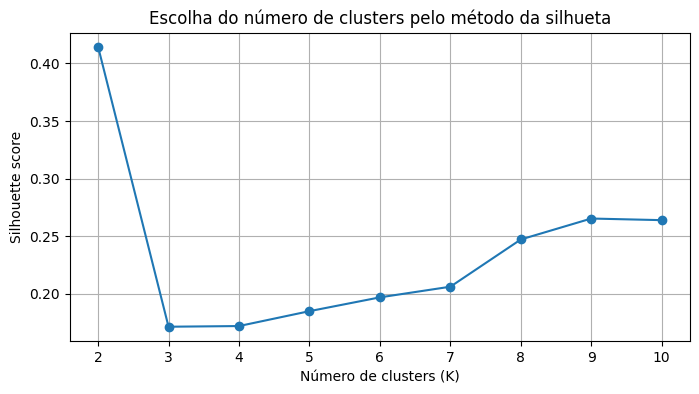

In [14]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 4))
plt.plot(list(ks), silhouette_scores, marker="o")
plt.xlabel("Número de clusters (K)")
plt.ylabel("Silhouette score")
plt.title("Escolha do número de clusters pelo método da silhueta")
plt.grid(True)
plt.show()


In [15]:
K_FINAL = 8

In [16]:
kmeans_final = KMeans(
    n_clusters=K_FINAL,
    random_state=42,
    n_init="auto"
)

clusters = kmeans_final.fit_predict(X_prep)

# Anexar ao dataframe original
df["cluster"] = clusters

df["cluster"].value_counts().sort_index()


cluster
0    3595
1    1811
2     974
3    1734
4     165
5       3
6      62
7    4196
Name: count, dtype: int64

In [17]:
df_setor = (
    df
    .groupby("CD_SETOR")
    .agg(
        total_clientes=("cluster", "count"),
        inadimplencia_media=("TEM_DEBITO", "mean"),
        consumo_medio_12m=("MEDIA_CONSUMO_12_MESES", "mean"),
        consumo_medio_24m=("MEDIA_CONSUMO_24_MESES", "mean"),
        debitos_medios=("QTD_DEBITOS_ABERTOS", "mean"),
        valor_medio_debito=("VALOR_TOTAL_ABERTO", "mean"),
        tempo_medio_ligacao=("TEMPO_LIGACAO_ANOS", "mean")
    )
    .reset_index()
)

df_setor.head()


,CD_SETOR,total_clientes,inadimplencia_media,consumo_medio_12m,consumo_medio_24m,debitos_medios,valor_medio_debito,tempo_medio_ligacao
0,355030883000009,58,0.810345,17.557619,15.371451,58.672414,4558.972759,13.783474
1,355030883000015,153,0.718954,29.169732,26.795252,24.901961,2227.904575,27.272716
2,355030883000040,173,0.826590,20.407927,20.577995,51.433526,4215.688382,18.737740
3,355030883000072,74,0.554054,25.704042,27.375928,35.405405,4550.835135,19.007603
4,355030883000076,62,0.403226,21.210884,18.055646,19.758065,1025.435645,22.808947


In [18]:
# 1) Contagem de clientes por setor e cluster
setor_cluster_counts = (
    df.groupby(["CD_SETOR", "cluster"])
      .size()
      .reset_index(name="qtd_clientes")
)

# 2) Total por setor
totais_setor = (
    setor_cluster_counts.groupby("CD_SETOR")["qtd_clientes"]
    .sum()
    .reset_index(name="total_clientes")
)

# 3) Juntar total e calcular percentual por cluster dentro do setor
setor_cluster = setor_cluster_counts.merge(totais_setor, on="CD_SETOR", how="left")
setor_cluster["pct_cluster_no_setor"] = setor_cluster["qtd_clientes"] / setor_cluster["total_clientes"]

# 4) Cluster dominante por setor
cluster_dominante = (
    setor_cluster.sort_values(["CD_SETOR", "pct_cluster_no_setor"], ascending=[True, False])
                .drop_duplicates("CD_SETOR")
                .rename(columns={
                    "cluster": "cluster_dominante",
                    "pct_cluster_no_setor": "pct_cluster_dominante",
                    "qtd_clientes": "qtd_cluster_dominante"
                })
    [["CD_SETOR", "cluster_dominante", "pct_cluster_dominante", "qtd_cluster_dominante"]]
)

cluster_dominante.head()


,CD_SETOR,cluster_dominante,pct_cluster_dominante,qtd_cluster_dominante
0,355030883000009,0,0.362069,21
11,355030883000015,7,0.418301,64
12,355030883000040,0,0.387283,67
21,355030883000072,3,0.283784,21
27,355030883000076,3,0.403226,25


In [19]:
# Juntar indicadores médios do setor com o cluster dominante
df_territorial = (
    df_setor
    .merge(cluster_dominante, on="CD_SETOR", how="left")
)

df_territorial.head()


,CD_SETOR,total_clientes,inadimplencia_media,consumo_medio_12m,consumo_medio_24m,debitos_medios,valor_medio_debito,tempo_medio_ligacao,cluster_dominante,pct_cluster_dominante,qtd_cluster_dominante
0,355030883000009,58,0.810345,17.557619,15.371451,58.672414,4558.972759,13.783474,0,0.362069,21
1,355030883000015,153,0.718954,29.169732,26.795252,24.901961,2227.904575,27.272716,7,0.418301,64
2,355030883000040,173,0.826590,20.407927,20.577995,51.433526,4215.688382,18.737740,0,0.387283,67
3,355030883000072,74,0.554054,25.704042,27.375928,35.405405,4550.835135,19.007603,3,0.283784,21
4,355030883000076,62,0.403226,21.210884,18.055646,19.758065,1025.435645,22.808947,3,0.403226,25


In [20]:
arquivo_ibge = "Paraisópolis.xlsx" 

df_ibge = pd.read_excel(arquivo_ibge)

df_ibge.shape


(76, 45)

In [21]:
df_ibge.head()


,id,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,...,Alfabetização 25 a 29,Alfabetização 30 a 34,Alfabetização 35 a 39,Alfabetização 40 a 44,Alfabetização 45 a 49,Alfabetização 50 a 54,Alfabetização 55 a 59,Alfabetização 60 a 64,Alfabetização 65 a 69,Alfabetização 70 a 80
0,90764,355030883000009,Urbana,1,1,0.016495,3,Sudeste,35,São Paulo,...,89.0,66.0,81.0,63.0,46.0,34.0,18.0,5.0,7.0,14.0
1,90894,355030883000210,Urbana,1,1,0.013716,3,Sudeste,35,São Paulo,...,105.0,120.0,106.0,123.0,54.0,74.0,32.0,16.0,9.0,28.0
2,90899,355030883000219,Urbana,1,1,0.009490,3,Sudeste,35,São Paulo,...,92.0,67.0,65.0,61.0,50.0,28.0,22.0,5.0,4.0,11.0
3,91019,355030883000346,Urbana,1,1,0.014818,3,Sudeste,35,São Paulo,...,114.0,126.0,89.0,236.0,119.0,109.0,44.0,11.0,7.0,34.0
4,91068,355030883000396,Urbana,1,1,0.005836,3,Sudeste,35,São Paulo,...,40.0,36.0,46.0,53.0,36.0,47.0,28.0,19.0,7.0,23.0


In [22]:
# 1) Selecionar colunas-base do IBGE
cols_ibge_base = [
    "CD_SETOR",
    "AREA_KM2",
    "Quantidade de pessoas",
    "Total de domicílios"
]

# 2) Selecionar automaticamente todas as colunas de alfabetização
cols_alfab = [c for c in df_ibge.columns if c.startswith("Alfabetização")]

# 3) Criar um indicador agregado de alfabetização (soma absoluta)
df_ibge["TOTAL_ALFABETIZADOS"] = df_ibge[cols_alfab].sum(axis=1)

# 4) Manter apenas as colunas necessárias
df_ibge_sel = df_ibge[cols_ibge_base + ["TOTAL_ALFABETIZADOS"]].copy()

df_ibge_sel.head()


,CD_SETOR,AREA_KM2,Quantidade de pessoas,Total de domicílios,TOTAL_ALFABETIZADOS
0,355030883000009,0.016495,881,328,595.0
1,355030883000210,0.013716,1295,476,921.0
2,355030883000219,0.009490,800,315,571.0
3,355030883000346,0.014818,1435,653,1137.0
4,355030883000396,0.005836,533,203,430.0


In [23]:
# Garantir tipos numéricos
df_ibge_sel["AREA_KM2"] = pd.to_numeric(df_ibge_sel["AREA_KM2"], errors="coerce")
df_ibge_sel["Quantidade de pessoas"] = pd.to_numeric(df_ibge_sel["Quantidade de pessoas"], errors="coerce")
df_ibge_sel["Total de domicílios"] = pd.to_numeric(df_ibge_sel["Total de domicílios"], errors="coerce")
df_ibge_sel["TOTAL_ALFABETIZADOS"] = pd.to_numeric(df_ibge_sel["TOTAL_ALFABETIZADOS"], errors="coerce")

# 1) Densidade populacional (pessoas / km²)
df_ibge_sel["DENSIDADE_POP_KM2"] = (
    df_ibge_sel["Quantidade de pessoas"] / df_ibge_sel["AREA_KM2"]
)

# 2) Pessoas por domicílio
df_ibge_sel["PESSOAS_POR_DOMICILIO"] = (
    df_ibge_sel["Quantidade de pessoas"] / df_ibge_sel["Total de domicílios"]
)

# 3) Taxa de alfabetização
df_ibge_sel["TAXA_ALFABETIZACAO"] = (
    df_ibge_sel["TOTAL_ALFABETIZADOS"] / df_ibge_sel["Quantidade de pessoas"]
)

df_ibge_sel[[
    "CD_SETOR",
    "DENSIDADE_POP_KM2",
    "PESSOAS_POR_DOMICILIO",
    "TAXA_ALFABETIZACAO"
]].describe()


,CD_SETOR,DENSIDADE_POP_KM2,PESSOAS_POR_DOMICILIO,TAXA_ALFABETIZACAO
count,7.600000e+01,76.000000,76.000000,76.000000
mean,3.550309e+14,78329.584156,2.561976,0.741962
std,9.761881e+01,40059.125436,0.212309,0.092151
min,3.550309e+14,238.642149,1.848341,0.000000
25%,3.550309e+14,50803.982474,2.494844,0.730778
50%,3.550309e+14,77389.638090,2.593021,0.752204
75%,3.550309e+14,98886.868107,2.711863,0.767229
max,3.550309e+14,266973.740088,2.842742,0.848718


In [24]:
# Juntar base territorial com indicadores do IBGE
df_setor_final = (
    df_territorial
    .merge(
        df_ibge_sel[
            [
                "CD_SETOR",
                "DENSIDADE_POP_KM2",
                "PESSOAS_POR_DOMICILIO",
                "TAXA_ALFABETIZACAO"
            ]
        ],
        on="CD_SETOR",
        how="left"
    )
)

df_setor_final.head()


,CD_SETOR,total_clientes,inadimplencia_media,consumo_medio_12m,consumo_medio_24m,debitos_medios,valor_medio_debito,tempo_medio_ligacao,cluster_dominante,pct_cluster_dominante,qtd_cluster_dominante,DENSIDADE_POP_KM2,PESSOAS_POR_DOMICILIO,TAXA_ALFABETIZACAO
0,355030883000009,58,0.810345,17.557619,15.371451,58.672414,4558.972759,13.783474,0,0.362069,21,53409.465878,2.685976,0.675369
1,355030883000015,153,0.718954,29.169732,26.795252,24.901961,2227.904575,27.272716,7,0.418301,64,51346.073371,2.600660,0.769036
2,355030883000040,173,0.826590,20.407927,20.577995,51.433526,4215.688382,18.737740,0,0.387283,67,35235.528944,2.432353,0.766626
3,355030883000072,74,0.554054,25.704042,27.375928,35.405405,4550.835135,19.007603,3,0.283784,21,70854.697287,2.833333,0.708978
4,355030883000076,62,0.403226,21.210884,18.055646,19.758065,1025.435645,22.808947,3,0.403226,25,30011.491144,2.569061,0.761290


In [25]:
# Variáveis do cluster territorial
features_setor = [
    "total_clientes",
    "inadimplencia_media",
    "consumo_medio_12m",
    "debitos_medios",
    "valor_medio_debito",
    "tempo_medio_ligacao",
    "pct_cluster_dominante",
    "DENSIDADE_POP_KM2",
    "PESSOAS_POR_DOMICILIO",
    "TAXA_ALFABETIZACAO"
]

X_setor = df_setor_final[features_setor].copy()

X_setor.describe()


,total_clientes,inadimplencia_media,consumo_medio_12m,debitos_medios,valor_medio_debito,tempo_medio_ligacao,pct_cluster_dominante,DENSIDADE_POP_KM2,PESSOAS_POR_DOMICILIO,TAXA_ALFABETIZACAO
count,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,76.000000,76.000000,76.000000
mean,147.529412,0.724723,23.639522,43.415411,3232.644228,20.551412,0.418354,78329.584156,2.561976,0.741962
std,102.248715,0.183514,16.217560,17.840251,1173.457629,5.146489,0.142845,40059.125436,0.212309,0.092151
min,1.000000,0.000000,6.214286,0.000000,0.000000,9.326032,0.256410,238.642149,1.848341,0.000000
25%,73.000000,0.672727,15.261378,34.500000,2578.272743,17.527676,0.335570,50803.982474,2.494844,0.730778
50%,141.000000,0.762712,19.829261,43.173913,3175.124737,19.971421,0.384615,77389.638090,2.593021,0.752204
75%,217.000000,0.830645,26.945775,50.206349,3899.314479,23.106210,0.459677,98886.868107,2.711863,0.767229
max,411.000000,1.000000,123.889807,142.000000,6318.201818,39.367556,1.000000,266973.740088,2.842742,0.848718


In [26]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# 1) Manter apenas setores completos (com IBGE)
X_setor_clean = X_setor.dropna().copy()

# 2) Normalização
scaler = StandardScaler()
X_setor_scaled = scaler.fit_transform(X_setor_clean)

# 3) Testar K pelo método da silhueta
ks = range(2, 7)
silhouette_scores_setor = []

for k in ks:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
    labels = kmeans.fit_predict(X_setor_scaled)
    score = silhouette_score(X_setor_scaled, labels)
    silhouette_scores_setor.append(score)
    print(f"K = {k} | Silhouette = {score:.4f}")

silhouette_scores_setor


K = 2 | Silhouette = 0.1742
K = 3 | Silhouette = 0.1540
K = 4 | Silhouette = 0.1500
K = 5 | Silhouette = 0.1535
K = 6 | Silhouette = 0.1607


[0.17423379761542387,
 0.15397127065417773,
 0.1499699781033196,
 0.15346684849187944,
 0.16065312022557549]

In [27]:
K_SETOR_FINAL = 2

In [28]:
kmeans_setor = KMeans(
    n_clusters=K_SETOR_FINAL,
    random_state=42,
    n_init="auto"
)

labels_setor = kmeans_setor.fit_predict(X_setor_scaled)

# Criar coluna de cluster territorial
df_setor_cluster = df_setor_final.loc[X_setor_clean.index].copy()
df_setor_cluster["cluster_territorial"] = labels_setor

df_setor_cluster["cluster_territorial"].value_counts().sort_index()


cluster_territorial
0    44
1    32
Name: count, dtype: int64

In [29]:
# centróide do setor a partir dos clientes
setor_centroid = (
    df.groupby("CD_SETOR")
      .agg(lat=("LATITUDE","mean"), lon=("LONGITUDE","mean"))
      .reset_index()
)

mapa_setor = df_setor_cluster.merge(setor_centroid, on="CD_SETOR", how="left")

mapa_setor[["CD_SETOR","cluster_territorial","lat","lon"]].head()


,CD_SETOR,cluster_territorial,lat,lon
0,355030883000009,0,-23.619414,-46.726910
1,355030883000015,1,-23.615677,-46.720301
2,355030883000040,0,-23.612535,-46.725318
3,355030883000072,1,-23.617958,-46.723991
4,355030883000076,1,-23.618092,-46.725741


In [30]:
import plotly.express as px

fig = px.scatter_mapbox(
    mapa_setor,
    lat="lat",
    lon="lon",
    color="cluster_territorial",
    size="total_clientes",
    hover_data=[
        "CD_SETOR",
        "inadimplencia_media",
        "valor_medio_debito",
        "DENSIDADE_POP_KM2",
        "TAXA_ALFABETIZACAO",
    ],
    zoom=13,
    height=650,
)

fig.update_layout(mapbox_style="open-street-map", margin=dict(l=0,r=0,t=30,b=0))
fig.show()


C:\Users\KelliVasconcelosGalv\AppData\Local\Temp\ipykernel_30496\1419611323.py:3: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(


In [31]:
import geopandas as gpd

gdf = gpd.read_file("LIG_Paraisopolis.shp")

# chave correta no shapefile
gdf["cd_setor"] = gdf["cd_setor"].astype(str).str.strip()

# chave no seu df de clusters (ajuste se o nome for outro)
df_setor_cluster["CD_SETOR"] = df_setor_cluster["CD_SETOR"].astype(str).str.strip()

# merge usando left_on/right_on (porque os nomes são diferentes)
gdf_plot = gdf.merge(
    df_setor_cluster,
    left_on="cd_setor",
    right_on="CD_SETOR",
    how="left"
)

# mapa
gdf_plot.explore(
    column="cluster_territorial",
    tooltip=["cd_setor", "cluster_territorial", "inadimplencia_media", "valor_medio_debito", "DENSIDADE_POP_KM2"],
    tiles="CartoDB positron"
)


In [36]:
# garantir a chave igual (string) para evitar erros de merge
df_cliente["CD_SETOR"] = df_cliente["CD_SETOR"].astype(str).str.strip()
df_setor_cluster["CD_SETOR"] = df_setor_cluster["CD_SETOR"].astype(str).str.strip()

# refazer o merge (remove coluna antiga se já existir)
if "cluster_territorial" in df_cliente.columns:
    df_cliente = df_cliente.drop(columns=["cluster_territorial"])

df_cliente = df_cliente.merge(
    df_setor_cluster[["CD_SETOR", "cluster_territorial"]],
    on="CD_SETOR",
    how="left"
)

df_cliente[["PDE","CD_SETOR","cluster","cluster_territorial"]].head()


,PDE,CD_SETOR,cluster,cluster_territorial
0,194075303,355030883000040,7,0.0
1,194082776,355030883000363,7,0.0
2,194082857,355030883000363,7,0.0
3,194082938,355030883000363,7,0.0
4,194083152,355030883000363,2,0.0


In [37]:
matriz_volume = pd.crosstab(
    df_cliente["cluster"],
    df_cliente["cluster_territorial"]
)

matriz_volume


cluster_territorial,0.0,1.0
cluster,,
0,2762,824
1,1376,431
2,553,416
3,1039,682
4,80,85
5,1,2
6,29,32
7,3233,947


In [38]:
matriz_percentual = pd.crosstab(
    df_cliente["cluster"],
    df_cliente["cluster_territorial"],
    normalize="columns"
) * 100

matriz_percentual.round(1)


cluster_territorial,0.0,1.0
cluster,,
0,30.4,24.1
1,15.2,12.6
2,6.1,12.2
3,11.5,19.9
4,0.9,2.5
5,0.0,0.1
6,0.3,0.9
7,35.6,27.7


In [39]:
cols_dashboard_clientes = [
    "PDE",
    "CD_SETOR",
    "cluster",
    "cluster_territorial",
    "TEM_DEBITO",
    "QTD_DEBITOS_ABERTOS",
    "VALOR_TOTAL_ABERTO",
    "MEDIA_CONSUMO_12_MESES",
    "MEDIA_CONSUMO_24_MESES",
    "QTD_IRREGULARIDADES",
    "TIPO_IMOVEL",
    "PERFIL_TARIFARIO",
    "ENQUADRA_TARIFA_SOCIAL",
    "LATITUDE",
    "LONGITUDE"
]

df_dashboard_clientes = df_cliente[cols_dashboard_clientes].copy()

df_dashboard_clientes.to_excel(
    "dashboard_clientes.xlsx",
    index=False
)

df_dashboard_clientes.head()


,PDE,CD_SETOR,cluster,cluster_territorial,TEM_DEBITO,QTD_DEBITOS_ABERTOS,VALOR_TOTAL_ABERTO,MEDIA_CONSUMO_12_MESES,MEDIA_CONSUMO_24_MESES,QTD_IRREGULARIDADES,TIPO_IMOVEL,PERFIL_TARIFARIO,ENQUADRA_TARIFA_SOCIAL,LATITUDE,LONGITUDE
0,194075303,355030883000040,7,0.0,1,1.0,89.52,20.769231,20.360000,0,RESIDENCIAL,SOCIAL - 50% DA TARIFA RESIDENCIAL,SIM,-23.611813,-46.725278
1,194082776,355030883000363,7,0.0,1,4.0,11380.14,0.000000,0.000000,0,RESIDENCIAL,SOCIAL,SIM,-23.614600,-46.730358
2,194082857,355030883000363,7,0.0,1,4.0,86.52,1.166667,1.750000,0,RESIDENCIAL,SOCIAL,SIM,-23.614557,-46.730353
3,194082938,355030883000363,7,0.0,1,22.0,537.61,0.833333,1.333333,0,RESIDENCIAL,SOCIAL - TRANSIÇÃO,SIM,-23.615223,-46.730255
4,194083152,355030883000363,2,0.0,0,0.0,0.00,11.083333,11.423077,1,DESCONHECIDO,DESCONHECIDO,SIM,-23.614367,-46.729672


In [40]:
cols_dashboard_setores = [
    "CD_SETOR",
    "cluster_territorial",
    "total_clientes",
    "inadimplencia_media",
    "consumo_medio_12m",
    "consumo_medio_24m",
    "debitos_medios",
    "valor_medio_debito",
    "tempo_medio_ligacao",
    "DENSIDADE_POP_KM2",
    "PESSOAS_POR_DOMICILIO",
    "TAXA_ALFABETIZACAO"
]

df_dashboard_setores = df_setor_cluster[cols_dashboard_setores].copy()

df_dashboard_setores.to_excel(
    "dashboard_setores.xlsx",
    index=False
)

df_dashboard_setores.head()


,CD_SETOR,cluster_territorial,total_clientes,inadimplencia_media,consumo_medio_12m,consumo_medio_24m,debitos_medios,valor_medio_debito,tempo_medio_ligacao,DENSIDADE_POP_KM2,PESSOAS_POR_DOMICILIO,TAXA_ALFABETIZACAO
0,355030883000009,0,58,0.810345,17.557619,15.371451,58.672414,4558.972759,13.783474,53409.465878,2.685976,0.675369
1,355030883000015,1,153,0.718954,29.169732,26.795252,24.901961,2227.904575,27.272716,51346.073371,2.600660,0.769036
2,355030883000040,0,173,0.826590,20.407927,20.577995,51.433526,4215.688382,18.737740,35235.528944,2.432353,0.766626
3,355030883000072,1,74,0.554054,25.704042,27.375928,35.405405,4550.835135,19.007603,70854.697287,2.833333,0.708978
4,355030883000076,1,62,0.403226,21.210884,18.055646,19.758065,1025.435645,22.808947,30011.491144,2.569061,0.761290


In [44]:
df_c = df[df["cluster"] == 3]
print(df_c["TEM_DEBITO"].value_counts(dropna=False))


TEM_DEBITO
0    1734
Name: count, dtype: int64


In [45]:
import pandas as pd
import numpy as np
import plotly.express as px

colunas_necessarias = [
    "cluster",
    "PERFIL_TARIFARIO",
    "TIPO_IMOVEL",
    "ENQUADRA_TARIFA_SOCIAL",
    "QTD_IRREGULARIDADES",
    "MEDIA_CONSUMO_12_MESES",
    "MEDIA_CONSUMO_24_MESES",
    "TEM_DEBITO",
    "QTD_DEBITOS_ABERTOS",
    "VALOR_TOTAL_ABERTO",
]

faltando = [c for c in colunas_necessarias if c not in df_cliente.columns]
print("Faltando:", faltando)
print("Linhas:", len(df_cliente))
df_cliente[["cluster"]].head()


Faltando: []
Linhas: 12540


,cluster
0,7
1,7
2,7
3,7
4,2


In [46]:
dfp = df_cliente.copy()

# cluster como inteiro (para ordenar melhor)
dfp["cluster"] = pd.to_numeric(dfp["cluster"], errors="coerce").astype("Int64")

# binárias
dfp["TEM_DEBITO"] = pd.to_numeric(dfp["TEM_DEBITO"], errors="coerce").fillna(0).astype(int)

# valores numéricos
for c in ["QTD_IRREGULARIDADES","MEDIA_CONSUMO_12_MESES","MEDIA_CONSUMO_24_MESES","QTD_DEBITOS_ABERTOS","VALOR_TOTAL_ABERTO"]:
    if c in dfp.columns:
        dfp[c] = pd.to_numeric(dfp[c], errors="coerce")

# categorias com nulos padronizados
for c in ["PERFIL_TARIFARIO","TIPO_IMOVEL","ENQUADRA_TARIFA_SOCIAL"]:
    if c in dfp.columns:
        dfp[c] = dfp[c].fillna("DESCONHECIDO").astype(str)

dfp.head()


,PDE,NR_ECON_IND,NR_ECON_RES,NR_ECON_PUB,TL,TIPO_IMOVEL,PERFIL_TARIFARIO,ENQUADRA_TARIFA_SOCIAL,QTD_IRREGULARIDADES,MEDIA_CONSUMO_12_MESES,...,LATITUDE,LONGITUDE,CD_SETOR,TOTAL_ECONOMIAS,QTD_TIPOS_ECONOMIA,TIPO_ECONOMIA_DOMINANTE,VALOR_TOTAL_ABERTO_LOG,TEMPO_LIGACAO_ANOS,cluster,cluster_territorial
0,194075303,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL - 50% DA TARIFA RESIDENCIAL,SIM,0,20.769231,...,-23.611813,-46.725278,355030883000040,1.0,1,RES,4.505571,47.301848,7,0.0
1,194082776,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL,SIM,0,0.000000,...,-23.614600,-46.730358,355030883000363,1.0,1,RES,9.339713,41.686516,7,0.0
2,194082857,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL,SIM,0,1.166667,...,-23.614557,-46.730353,355030883000363,1.0,1,RES,4.471867,39.260780,7,0.0
3,194082938,0.0,1.0,0.0,1,RESIDENCIAL,SOCIAL - TRANSIÇÃO,SIM,0,0.833333,...,-23.615223,-46.730255,355030883000363,1.0,1,RES,6.288992,37.913758,7,0.0
4,194083152,0.0,0.0,0.0,1,DESCONHECIDO,DESCONHECIDO,SIM,1,11.083333,...,-23.614367,-46.729672,355030883000363,0.0,0,SEM_ECONOMIA,0.000000,43.049966,2,0.0


In [47]:
# Tabela de %: para cada cluster, qual % está em cada perfil tarifário
tab_tarifa = (
    dfp.groupby(["cluster","PERFIL_TARIFARIO"])
       .size()
       .reset_index(name="n")
)

tot_cluster = dfp.groupby("cluster").size().reset_index(name="total")
tab_tarifa = tab_tarifa.merge(tot_cluster, on="cluster", how="left")
tab_tarifa["pct"] = (tab_tarifa["n"] / tab_tarifa["total"] * 100)

# manter só os top perfis para ficar legível (ajuste se quiser)
top_perf = (
    dfp["PERFIL_TARIFARIO"].value_counts()
       .head(6)
       .index
)
tab_tarifa_top = tab_tarifa[tab_tarifa["PERFIL_TARIFARIO"].isin(top_perf)].copy()

tab_tarifa_top.sort_values(["PERFIL_TARIFARIO","cluster"]).head(10)


,cluster,PERFIL_TARIFARIO,n,total,pct
17,2,DESCONHECIDO,894,974,91.786448
37,6,DESCONHECIDO,28,62,45.161290
0,0,FAVELA NORMAL,932,3595,25.924896
8,1,FAVELA NORMAL,150,1811,8.282717
19,3,FAVELA NORMAL,202,1734,11.649366
28,4,FAVELA NORMAL,11,165,6.666667
38,6,FAVELA NORMAL,16,62,25.806452
46,7,FAVELA NORMAL,120,4196,2.859867
2,0,NORMAL,48,3595,1.335188
10,1,NORMAL,23,1811,1.270017


In [48]:
fig = px.bar(
    tab_tarifa_top,
    x="cluster",
    y="pct",
    facet_col="PERFIL_TARIFARIO",
    facet_col_wrap=3,
    title="Perfil tarifário (% por cluster) — Top 6 perfis",
)

fig.update_layout(
    yaxis_title="% no cluster",
    xaxis_title="Cluster",
    showlegend=False,
    height=650
)

fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))  # limpa rótulo facet
fig.show()


In [49]:
tab_imovel = (
    dfp.groupby(["cluster","TIPO_IMOVEL"])
       .size()
       .reset_index(name="n")
)

tot_cluster = dfp.groupby("cluster").size().reset_index(name="total")
tab_imovel = tab_imovel.merge(tot_cluster, on="cluster", how="left")
tab_imovel["pct"] = (tab_imovel["n"] / tab_imovel["total"] * 100)

tab_imovel.head()


,cluster,TIPO_IMOVEL,n,total,pct
0,0,COMERCIAL,1,3595,0.027816
1,0,MISTA,2,3595,0.055633
2,0,RESIDENCIAL,3592,3595,99.916551
3,1,COMERCIAL,2,1811,0.110436
4,1,MISTA,2,1811,0.110436


In [50]:
fig = px.bar(
    tab_imovel,
    x="cluster",
    y="pct",
    color="TIPO_IMOVEL",
    barmode="group",
    title="Tipo de imóvel (% por cluster)",
)

fig.update_layout(
    yaxis_title="% no cluster",
    xaxis_title="Cluster",
    height=450
)

fig.show()


In [51]:
dfp["TARIFA_SOCIAL_SIM"] = (dfp["ENQUADRA_TARIFA_SOCIAL"].str.upper() == "SIM").astype(int)

kpis = (
    dfp.groupby("cluster")
       .agg(
           pct_tarifa_social=("TARIFA_SOCIAL_SIM", "mean"),
           pct_inadimplente=("TEM_DEBITO", "mean")
       )
       .reset_index()
)

kpis["pct_tarifa_social"] *= 100
kpis["pct_inadimplente"] *= 100

kpis_long = kpis.melt(id_vars="cluster", var_name="indicador", value_name="pct")
kpis_long["indicador"] = kpis_long["indicador"].replace({
    "pct_tarifa_social": "% Tarifa social (SIM)",
    "pct_inadimplente": "% Inadimplentes (TEM_DEBITO=1)",
})

fig = px.bar(
    kpis_long,
    x="cluster",
    y="pct",
    color="indicador",
    barmode="group",
    title="% Tarifa social e % inadimplência por cluster"
)

fig.update_layout(yaxis_title="%", xaxis_title="Cluster", height=450)
fig.show()


In [52]:
cons = (
    dfp.groupby("cluster")
       .agg(consumo_12m=("MEDIA_CONSUMO_12_MESES","mean"),
            consumo_24m=("MEDIA_CONSUMO_24_MESES","mean"))
       .reset_index()
)

cons_long = cons.melt(id_vars="cluster", var_name="janela", value_name="m3")
cons_long["janela"] = cons_long["janela"].replace({
    "consumo_12m": "Consumo médio (12m)",
    "consumo_24m": "Consumo médio (24m)",
})

fig = px.line(
    cons_long,
    x="cluster",
    y="m3",
    color="janela",
    markers=True,
    title="Consumo médio por cluster (12m vs 24m)"
)

fig.update_layout(yaxis_title="m³", xaxis_title="Cluster", height=450)
fig.show()


In [55]:
df_cliente["TIPO_IMOVEL"] = (
    df_cliente["TIPO_IMOVEL"]
    .replace("DESCONHECIDO", "RESIDENCIAL")
)
